In [1]:
import os
import cv2
import numpy as np
from lxml import etree
from skimage.io import imread, imsave
import matplotlib.pyplot as plt
from skimage.segmentation import slic, mark_boundaries
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import skfuzzy as fuzz
from scipy.cluster.hierarchy import linkage, fcluster
import imageio.v2 as imageio

import tifffile

In [2]:
def xml_to_masks(xml_path, image_shape):
    tree = etree.parse(xml_path)
    root = tree.getroot()

    gt_mask = np.zeros(image_shape[:2], dtype=np.uint8)       # Binary mask
    instance_mask = np.zeros(image_shape[:2], dtype=np.uint16)  # Unique ID mask

    label_id = 1

    for annotation in root.findall('.//Annotation'):
        for region in annotation.findall('.//Region'):
            points = []
            for vertex in region.findall('.//Vertex'):
                x = float(vertex.get('X'))
                y = float(vertex.get('Y'))
                points.append((int(x), int(y)))

            if len(points) >= 3:
                contour = np.array(points, dtype=np.int32)
                cv2.fillPoly(gt_mask, [contour], 255)
                cv2.fillPoly(instance_mask, [contour], label_id)
                label_id += 1

    return gt_mask, instance_mask

# Load image
image_path = 'TCGA-21-5784-01Z-00-DX1.tif'
xml_path = 'TCGA-21-5784-01Z-00-DX1.xml'
image = imread(image_path)

# Generate GT and instance masks
gt_mask, instance_mask = xml_to_masks(xml_path, image.shape)

# Save masks
imsave('gt_mask.png', gt_mask.astype(np.uint8))         # Binary mask
cv2.imwrite('instance_mask.png', instance_mask)          # 16-bit instance mask



True

[Elbow] KMeans best k: 7, FCM best c: 7, using k=7


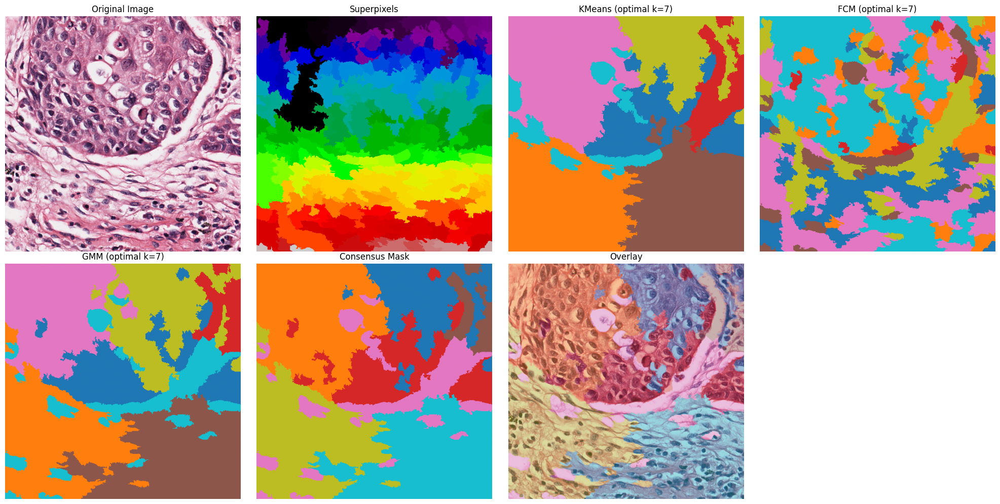

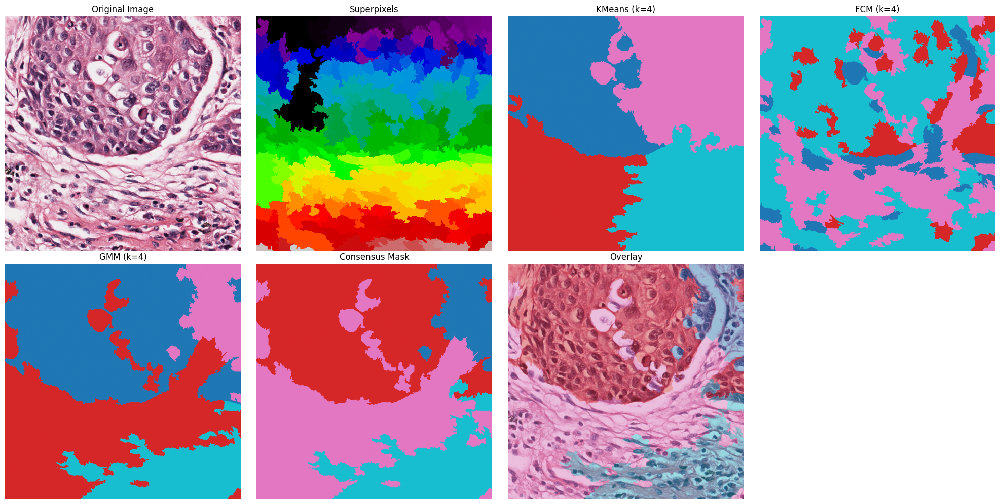

In [3]:
def extract_features(image, segments):
    h, w = image.shape[:2]
    features = []
    for sp_label in range(segments.max() + 1):
        mask = (segments == sp_label)
        mean_color = image[mask].mean(axis=0)
        coords = np.column_stack(np.where(mask))
        mean_x = coords[:, 1].mean() / w
        mean_y = coords[:, 0].mean() / h
        features.append(np.concatenate([mean_color, [mean_x, mean_y]]))
    return np.array(features)

def consensus_clustering(label_lists, n_clusters):
    n = len(label_lists[0])
    coassoc = np.zeros((n, n))
    for labels in label_lists:
        for i in range(n):
            for j in range(n):
                if labels[i] == labels[j]:
                    coassoc[i, j] += 1
    coassoc /= len(label_lists)
    dist = 1 - coassoc
    Z = linkage(dist[np.triu_indices(n, 1)], method='average')
    consensus = fcluster(Z, t=n_clusters, criterion='maxclust') - 1
    return consensus

def elbow_kmeans_gmm(features, max_k=10):
    ks = list(range(2, max_k+1))
    kmeans_scores, gmm_scores = [], []
    for k in ks:
        kmeans = KMeans(n_clusters=k, random_state=42).fit(features)
        kmeans_scores.append(kmeans.inertia_)
        gmm = GaussianMixture(n_components=k, random_state=42).fit(features)
        gmm_scores.append(-gmm.score(features))
    return ks, kmeans_scores, gmm_scores

def elbow_fcm(features, max_c=10):
    cs = list(range(2, max_c+1))
    fcm_errors = []
    for c in cs:
        _, _, _, _, _, _, fcm_obj = fuzz.cluster.cmeans(
            features[:, :3].T, c=c, m=2, error=0.005, maxiter=500, init=None)
        fcm_errors.append(fcm_obj)
    return cs, fcm_errors

def find_elbow(scores):
    # Find the "elbow" using 2nd derivative approximation
    diff1 = np.diff(scores)
    diff2 = np.diff(diff1)
    elbow_index = np.argmin(diff2) + 2  # offset due to double diff
    return elbow_index

def cluster_with_methods(features, segments, n_clusters):
    n_sp = features.shape[0]
    masks = {}

    # KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(features)
    k_labels = kmeans.labels_
    masks['kmeans'] = map_labels_to_image(k_labels, segments)

    # FCM
    _, u, _, _, _, _, _ = fuzz.cluster.cmeans(
        features[:, :3].T, c=n_clusters, m=2, error=0.005, maxiter=500, init=None)
    f_labels = np.argmax(u, axis=0)
    masks['fcm'] = map_labels_to_image(f_labels, segments)

    # GMM
    gmm = GaussianMixture(n_components=n_clusters, random_state=42).fit(features)
    g_labels = gmm.predict(features)
    masks['gmm'] = map_labels_to_image(g_labels, segments)

    # Consensus
    consensus = consensus_clustering([k_labels, f_labels, g_labels], n_clusters)
    masks['consensus'] = map_labels_to_image(consensus, segments)

    return masks

def map_labels_to_image(labels, segments):
    out = np.zeros_like(segments)
    for i, lbl in enumerate(labels):
        out[segments == i] = lbl
    return out

def visualize_all(image, segments, masks, title_suffix):
    plt.figure(figsize=(20, 10))

    plt.subplot(2, 4, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(2, 4, 2)
    plt.imshow(segments, cmap='nipy_spectral')
    plt.title("Superpixels")
    plt.axis("off")

    plt.subplot(2, 4, 3)
    plt.imshow(masks['kmeans'], cmap='tab10')
    plt.title(f"KMeans ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 4)
    plt.imshow(masks['fcm'], cmap='tab10')
    plt.title(f"FCM ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 5)
    plt.imshow(masks['gmm'], cmap='tab10')
    plt.title(f"GMM ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 6)
    plt.imshow(masks['consensus'], cmap='tab10')
    plt.title("Consensus Mask")
    plt.axis("off")

    plt.subplot(2, 4, 7)
    plt.imshow(image)
    plt.imshow(masks['consensus'], cmap='tab10', alpha=0.4)
    plt.title("Overlay")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def main():
    image_path = 'TCGA-21-5784-01Z-00-DX1.tif'
    image = tifffile.imread(image_path)
    max_dim = 512
    scale = max_dim / max(image.shape[:2])
    if scale < 1:
        image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))
    image_float = image.astype(np.float32) / 255.0

    segments = slic(image_float, n_segments=500, compactness=10, start_label=0)
    features = extract_features(image_float, segments)

    # Elbow Methods
    ks, kmeans_scores, gmm_scores = elbow_kmeans_gmm(features)
    cs, fcm_scores = elbow_fcm(features)

    best_k = ks[find_elbow(kmeans_scores)]
    best_c = cs[find_elbow(fcm_scores)]
    final_k = int(np.median([best_k, best_c]))

    print(f"[Elbow] KMeans best k: {best_k}, FCM best c: {best_c}, using k={final_k}")

    # Run with optimal k
    masks_elbow = cluster_with_methods(features, segments, final_k)
    visualize_all(image, segments, masks_elbow, f"optimal k={final_k}")

    # Run with default k=4
    masks_k4 = cluster_with_methods(features, segments, 4)
    visualize_all(image, segments, masks_k4, "k=4")

if __name__ == "__main__":
    main()

[ELBOW RESULTS] KMeans best k: 7, GMM best k: 7, FCM best c: 7 => Using consensus k=7


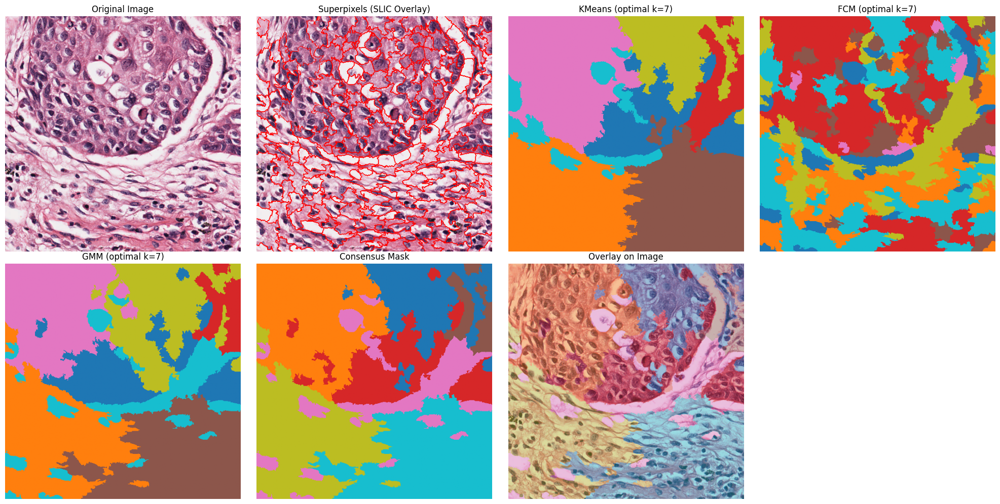

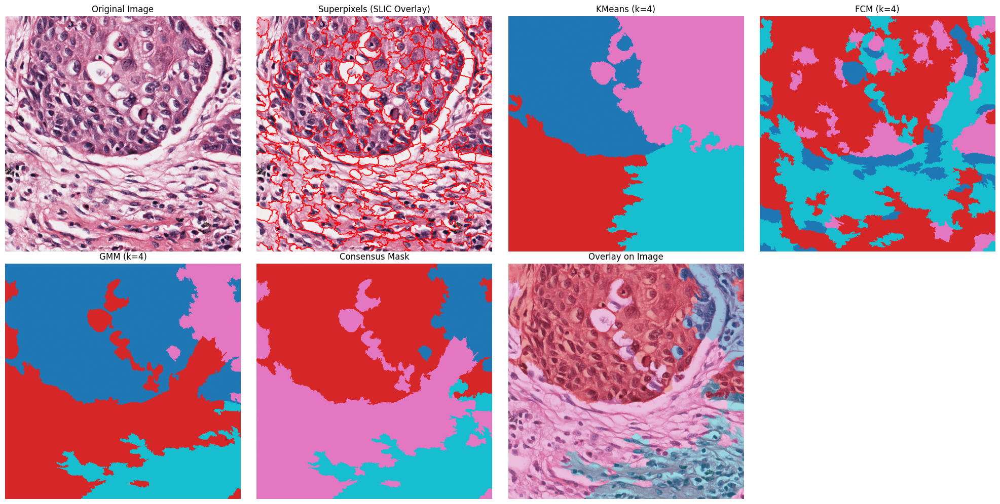

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.segmentation import slic, mark_boundaries
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import skfuzzy as fuzz
from scipy.cluster.hierarchy import linkage, fcluster
import tifffile

def extract_features(image, segments):
    h, w = image.shape[:2]
    features = []
    for sp_label in range(segments.max() + 1):
        mask = (segments == sp_label)
        mean_color = image[mask].mean(axis=0)
        coords = np.column_stack(np.where(mask))
        mean_x = coords[:, 1].mean() / w
        mean_y = coords[:, 0].mean() / h
        features.append(np.concatenate([mean_color, [mean_x, mean_y]]))
    return np.array(features)

def consensus_clustering(label_lists, n_clusters):
    n = len(label_lists[0])
    coassoc = np.zeros((n, n))
    for labels in label_lists:
        for i in range(n):
            for j in range(n):
                if labels[i] == labels[j]:
                    coassoc[i, j] += 1
    coassoc /= len(label_lists)
    dist = 1 - coassoc
    Z = linkage(dist[np.triu_indices(n, 1)], method='average')
    consensus = fcluster(Z, t=n_clusters, criterion='maxclust') - 1
    return consensus

def elbow_kmeans_gmm(features, max_k=10):
    ks = list(range(2, max_k + 1))
    kmeans_scores, gmm_scores = [], []
    for k in ks:
        kmeans = KMeans(n_clusters=k, random_state=42).fit(features)
        kmeans_scores.append(kmeans.inertia_)
        gmm = GaussianMixture(n_components=k, random_state=42).fit(features)
        gmm_scores.append(-gmm.score(features))  # lower is better
    return ks, kmeans_scores, gmm_scores

def elbow_fcm(features, max_c=10):
    cs = list(range(2, max_c + 1))
    fcm_errors = []
    for c in cs:
        _, _, _, _, _, _, fcm_obj = fuzz.cluster.cmeans(
            features[:, :3].T, c=c, m=2, error=0.005, maxiter=500, init=None)
        fcm_errors.append(fcm_obj)
    return cs, fcm_errors

def find_elbow(scores):
    diff1 = np.diff(scores)
    diff2 = np.diff(diff1)
    elbow_index = np.argmin(diff2) + 2  # Offset for 2nd diff
    return elbow_index

def cluster_with_methods(features, segments, n_clusters):
    n_sp = features.shape[0]
    masks = {}

    # KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(features)
    k_labels = kmeans.labels_
    masks['kmeans'] = map_labels_to_image(k_labels, segments)

    # FCM
    _, u, _, _, _, _, _ = fuzz.cluster.cmeans(
        features[:, :3].T, c=n_clusters, m=2, error=0.005, maxiter=500, init=None)
    f_labels = np.argmax(u, axis=0)
    masks['fcm'] = map_labels_to_image(f_labels, segments)

    # GMM
    gmm = GaussianMixture(n_components=n_clusters, random_state=42).fit(features)
    g_labels = gmm.predict(features)
    masks['gmm'] = map_labels_to_image(g_labels, segments)

    # Consensus
    consensus = consensus_clustering([k_labels, f_labels, g_labels], n_clusters)
    masks['consensus'] = map_labels_to_image(consensus, segments)

    return masks

def map_labels_to_image(labels, segments):
    out = np.zeros_like(segments)
    for i, lbl in enumerate(labels):
        out[segments == i] = lbl
    return out

def visualize_all(image, segments, masks, title_suffix):
    plt.figure(figsize=(20, 10))

    # Superpixel overlay
    superpixel_overlay = mark_boundaries(image, segments, color=(1, 0, 0))  # red

    plt.subplot(2, 4, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(2, 4, 2)
    plt.imshow(superpixel_overlay)
    plt.title("Superpixels (SLIC Overlay)")
    plt.axis("off")

    plt.subplot(2, 4, 3)
    plt.imshow(masks['kmeans'], cmap='tab10')
    plt.title(f"KMeans ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 4)
    plt.imshow(masks['fcm'], cmap='tab10')
    plt.title(f"FCM ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 5)
    plt.imshow(masks['gmm'], cmap='tab10')
    plt.title(f"GMM ({title_suffix})")
    plt.axis("off")

    plt.subplot(2, 4, 6)
    plt.imshow(masks['consensus'], cmap='tab10')
    plt.title("Consensus Mask")
    plt.axis("off")

    plt.subplot(2, 4, 7)
    plt.imshow(image)
    plt.imshow(masks['consensus'], cmap='tab10', alpha=0.4)
    plt.title("Overlay on Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def main():
    image_path = 'TCGA-21-5784-01Z-00-DX1.tif'
    image = tifffile.imread(image_path)
    max_dim = 512
    scale = max_dim / max(image.shape[:2])
    if scale < 1:
        image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))
    image_float = image.astype(np.float32) / 255.0

    # SLIC Superpixels
    segments = slic(image_float, n_segments=500, compactness=10, start_label=0)
    features = extract_features(image_float, segments)

    # Elbow analysis
    ks, kmeans_scores, gmm_scores = elbow_kmeans_gmm(features)
    cs, fcm_scores = elbow_fcm(features)

    best_k = ks[find_elbow(kmeans_scores)]
    best_gmm = ks[find_elbow(gmm_scores)]
    best_c = cs[find_elbow(fcm_scores)]
    final_k = int(np.median([best_k, best_gmm, best_c]))

    print(f"[ELBOW RESULTS] KMeans best k: {best_k}, GMM best k: {best_gmm}, FCM best c: {best_c} => Using consensus k={final_k}")

    # Clustering and visualization - optimal k
    masks_elbow = cluster_with_methods(features, segments, final_k)
    visualize_all(image_float, segments, masks_elbow, f"optimal k={final_k}")

    # Clustering and visualization - default k=4
    masks_k4 = cluster_with_methods(features, segments, 4)
    visualize_all(image_float, segments, masks_k4, "k=4")

if __name__ == "__main__":
    main()


In [5]:
def visualize_and_save(image, segments, masks, title_suffix, save_dir):
    import matplotlib.colors as mcolors
    from matplotlib import cm

    os.makedirs(save_dir, exist_ok=True)

    # Save superpixel segmentation as .npy
    np.save(os.path.join(save_dir, f"segments.npy"), segments)

    # Save masks as .npy and individually as .png with colorbar
    for key, mask in masks.items():
        np.save(os.path.join(save_dir, f"{key}_{title_suffix}.npy"), mask)
        fig, ax = plt.subplots(figsize=(6, 6))
        im = ax.imshow(mask, cmap='tab10', vmin=0, vmax=np.max(mask))
        ax.set_title(f"{key.upper()} Segmentation ({title_suffix})", fontsize=12, fontweight='bold')
        ax.axis('off')
        cbar = plt.colorbar(im, ax=ax, ticks=range(np.max(mask)+1), shrink=0.8)
        cbar.set_label('Cluster Index', rotation=270, labelpad=15)
        plt.tight_layout()
        plt.savefig(os.path.join(save_dir, f"{key}_{title_suffix}.png"), dpi=300, bbox_inches='tight')
        plt.close(fig)

    # Save overlay of consensus on image
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(image)
    ax.imshow(masks['consensus'], cmap='tab10', alpha=0.4, vmin=0, vmax=np.max(masks['consensus']))
    ax.set_title(f"Overlay on Original ({title_suffix})", fontsize=12, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, f"overlay_{title_suffix}.png"), dpi=300, bbox_inches='tight')
    plt.close(fig)

    # Save superpixel overlay
    overlay = mark_boundaries(image, segments, color=(1, 0, 0))
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(overlay)
    ax.set_title("Superpixels (SLIC Overlay)", fontsize=12, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, f"superpixels_overlay_{title_suffix}.png"), dpi=300, bbox_inches='tight')
    plt.close(fig)

    # Save original image
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(image)
    ax.set_title("Original Image", fontsize=12, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, f"original_image_{title_suffix}.png"), dpi=300, bbox_inches='tight')
    plt.close(fig)

    # Save composite grid
    fig, axes = plt.subplots(2, 4, figsize=(22, 12), facecolor='white')
    ax = axes.ravel()
    titles = [
        "Original Image", "Superpixels (SLIC)",
        f"KMeans ({title_suffix})", f"FCM ({title_suffix})",
        f"GMM ({title_suffix})", "Consensus Mask",
        "Overlay on Original", ""
    ]
    imgs = [
        image, overlay, masks['kmeans'], masks['fcm'],
        masks['gmm'], masks['consensus'], None, None
    ]

    for i in range(7):
        if i == 6:
            ax[i].imshow(image)
            ax[i].imshow(masks['consensus'], cmap='tab10', alpha=0.4)
        elif i in [2, 3, 4, 5]:
            im = ax[i].imshow(imgs[i], cmap='tab10', vmin=0, vmax=np.max(imgs[i]))
            cbar = plt.colorbar(im, ax=ax[i], ticks=range(np.max(imgs[i])+1), shrink=0.8)
        else:
            ax[i].imshow(imgs[i])
        ax[i].set_title(titles[i], fontsize=14, fontweight='bold')
        ax[i].axis("off")

    ax[7].axis('off')
    fig.suptitle(f"Superpixel & Segmentation Results – {title_suffix.upper()}", fontsize=18, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, f"composite_{title_suffix}.png"), dpi=300, bbox_inches='tight')
    plt.close(fig)

    print(f" Saved all plots for: {title_suffix}")


In [8]:
import os
import cv2
import tifffile
import numpy as np
from skimage.segmentation import slic

# --- Load and preprocess image ---
image_path = 'TCGA-21-5784-01Z-00-DX1.tif'
xml_path = 'TCGA-21-5784-01Z-00-DX1.xml'

image = tifffile.imread(image_path)
max_dim = 512
scale = max_dim / max(image.shape[:2])
if scale < 1:
    image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))

image_float = image.astype(np.float32) / 255.0

# --- Superpixel segmentation ---
segments = slic(image_float, n_segments=500, compactness=10, start_label=0)

# --- Extract features ---
features = extract_features(image_float, segments)

# --- Compute optimal k values ---
ks, kmeans_scores, gmm_scores = elbow_kmeans_gmm(features)
cs, fcm_scores = elbow_fcm(features)

best_k = ks[find_elbow(kmeans_scores)]
best_gmm = ks[find_elbow(gmm_scores)]
best_c = cs[find_elbow(fcm_scores)]
final_k = int(np.median([best_k, best_gmm, best_c]))

# --- Generate cluster masks ---
masks_elbow = cluster_with_methods(features, segments, final_k)
masks_k4 = cluster_with_methods(features, segments, 4)

# --- Load GT mask from XML ---
gt_mask_path = 'gt_mask.png'  # adjust path if needed
gt_mask = imageio.imread(gt_mask_path)
gt_mask = (gt_mask > 0).astype(np.uint8)  # ensure it's binary (0 or 1)


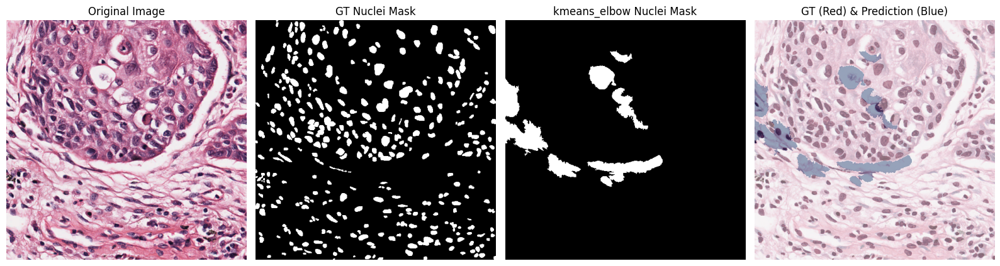

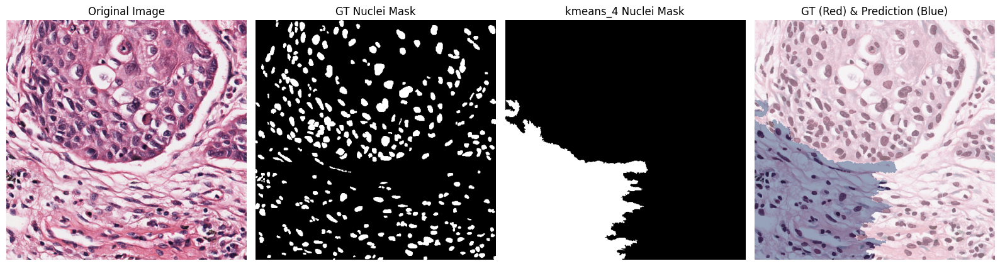

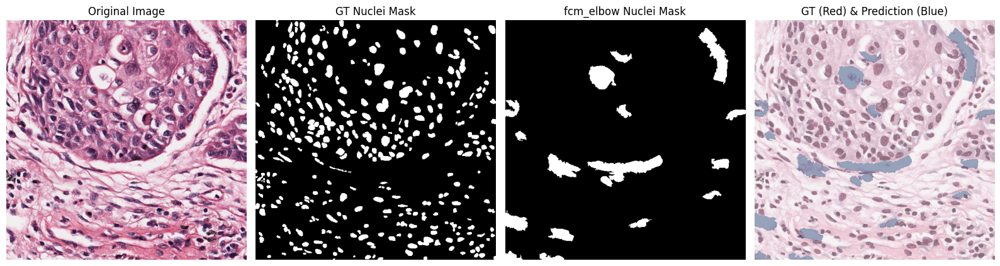

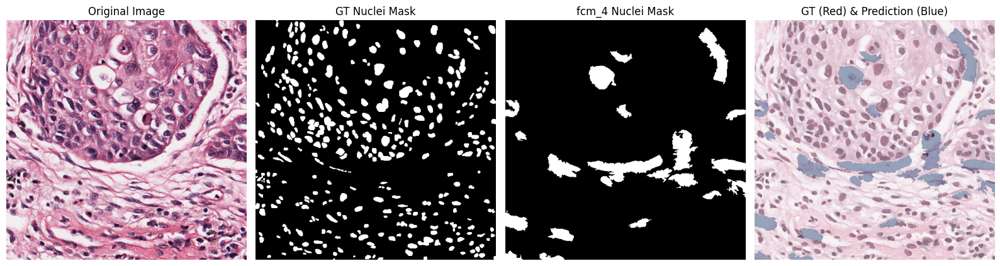

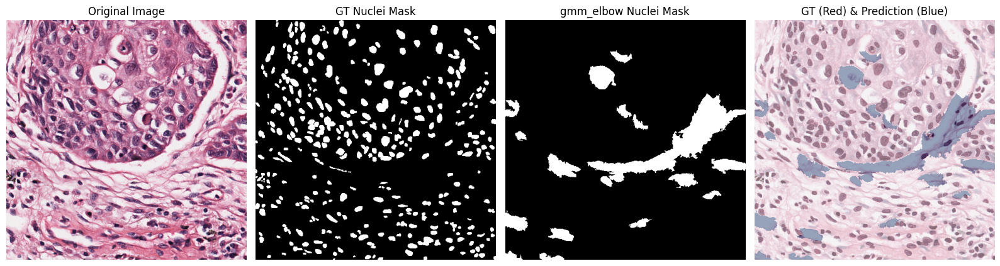

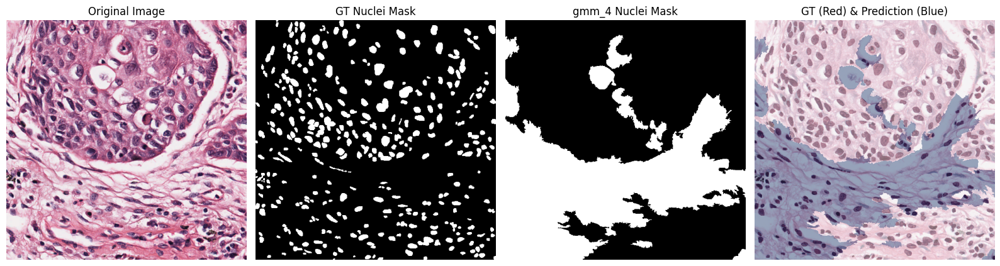

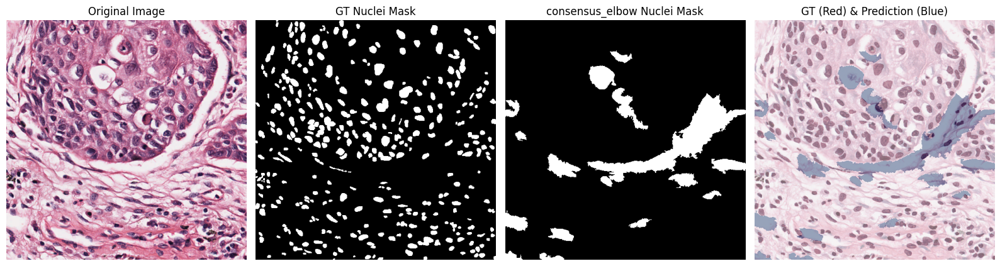

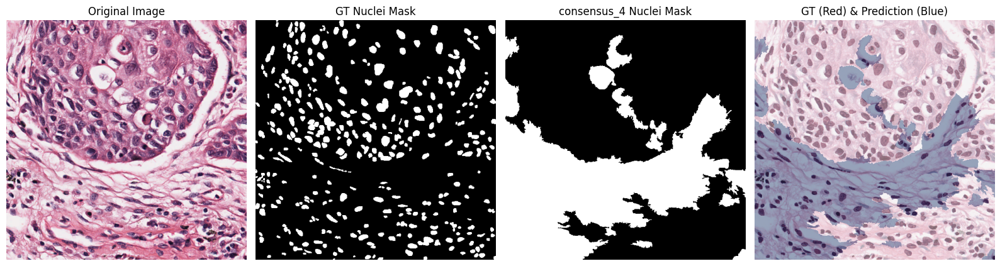

         Method     Dice      IoU   TP    FP     TN    FN
       kmeans_4 0.126493 0.067516 6282 57209 169100 29553
          gmm_4 0.121752 0.064822 8302 92239 134070 27533
    consensus_4 0.119578 0.063591 8009 90110 136199 27826
   kmeans_elbow 0.028633 0.014525  747 15595 210714 35088
consensus_elbow 0.026899 0.013633  869 27907 198402 34966
      gmm_elbow 0.021480 0.010857  681 26891 199418 35154
          fcm_4 0.004809 0.002410  145 24328 201981 35690
      fcm_elbow 0.001478 0.000739   40 18256 208053 35795


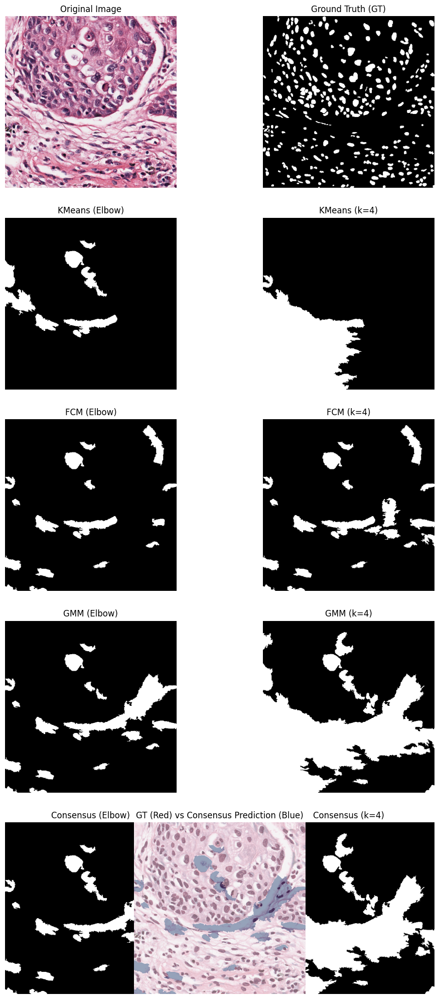

In [9]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

def binarize_cluster_mask(mask, image_gray, nuclei_cluster_method='max_intensity'):
    """
    Convert cluster mask to binary nuclei mask.
    nuclei_cluster_method: 
        'max_intensity' - choose cluster with highest mean intensity in grayscale image
        'min_intensity' - choose cluster with lowest mean intensity (e.g. nuclei darker)
    """
    unique_labels = np.unique(mask)
    means = []
    for label in unique_labels:
        cluster_pixels = image_gray[mask == label]
        means.append(cluster_pixels.mean())
    means = np.array(means)

    if nuclei_cluster_method == 'max_intensity':
        nuclei_label = unique_labels[np.argmax(means)]
    elif nuclei_cluster_method == 'min_intensity':
        nuclei_label = unique_labels[np.argmin(means)]
    else:
        raise ValueError("nuclei_cluster_method must be 'max_intensity' or 'min_intensity'")
    
    binary_mask = (mask == nuclei_label).astype(np.uint8)
    return binary_mask

def dice_coefficient(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + 1e-7)

def iou_score(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return intersection / (union + 1e-7)

def confusion_stats(y_true, y_pred):
    """
    Compute TP, FP, TN, FN counts from binary masks.
    """
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
    return tp, fp, tn, fn

def visualize_comparison(image, gt_mask, pred_mask, title_pred, save_path=None):
    plt.figure(figsize=(16, 5))

    plt.subplot(1, 4, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(gt_mask, cmap='gray')
    plt.title("GT Nuclei Mask")
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.imshow(pred_mask, cmap='gray')
    plt.title(f"{title_pred} Nuclei Mask")
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(image)
    plt.imshow(gt_mask, cmap='Reds', alpha=0.4)
    plt.imshow(pred_mask, cmap='Blues', alpha=0.4)
    plt.title("GT (Red) & Prediction (Blue)")
    plt.axis('off')

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()
    plt.close()

def evaluate_and_visualize_all(image, gt_mask, masks_dict, save_dir, nuclei_cluster_method='max_intensity'):
    """
    masks_dict example:
    {
        'kmeans_elbow': mask,
        'fcm_elbow': mask,
        'gmm_elbow': mask,
        'consensus_elbow': mask,
        'kmeans_4': mask,
        'fcm_4': mask,
        'gmm_4': mask,
        'consensus_4': mask
    }
    """
    os.makedirs(save_dir, exist_ok=True)

    # convert original image to grayscale for cluster binarization
    image_gray = image.mean(axis=2) if image.ndim == 3 else image

    results = []

    for name, mask in masks_dict.items():
        pred_binary = binarize_cluster_mask(mask, image_gray, nuclei_cluster_method)
        dice = dice_coefficient(gt_mask, pred_binary)
        iou = iou_score(gt_mask, pred_binary)
        tp, fp, tn, fn = confusion_stats(gt_mask, pred_binary)
        results.append({
            'Method': name,
            'Dice': dice,
            'IoU': iou,
            'TP': tp,
            'FP': fp,
            'TN': tn,
            'FN': fn
        })

        # Save visualization
        save_path = os.path.join(save_dir, f"{name}_evaluation.png")
        visualize_comparison(image, gt_mask, pred_binary, title_pred=name, save_path=save_path)

    # Print summary table
    import pandas as pd
    df = pd.DataFrame(results)
    print(df.sort_values('Dice', ascending=False).to_string(index=False))
    return df
def visualize_summary_comparison(image, gt_mask, all_masks, save_path, nuclei_cluster_method='max_intensity'):
    """
    Create a composite visualization comparing all methods.
    """
    import matplotlib.pyplot as plt

    image_gray = image.mean(axis=2) if image.ndim == 3 else image
    fig, axes = plt.subplots(5, 2, figsize=(12, 20))
    axes = axes.flatten()

    titles = [
        "Original Image",
        "GT Mask",
        "KMeans (Elbow)", "KMeans (k=4)",
        "FCM (Elbow)", "FCM (k=4)",
        "GMM (Elbow)", "GMM (k=4)",
        "Consensus (Elbow)", "Consensus (k=4)",
    ]

    pred_masks = {}

    for i, (name, mask) in enumerate(all_masks.items()):
        if name not in ['kmeans_elbow', 'kmeans_4', 'fcm_elbow', 'fcm_4', 'gmm_elbow', 'gmm_4', 'consensus_elbow', 'consensus_4']:
            continue
        pred_binary = binarize_cluster_mask(mask, image_gray, nuclei_cluster_method)
        pred_masks[name] = pred_binary
        axes[i+2].imshow(pred_binary, cmap='gray')
        axes[i+2].set_title(titles[i+2])
        axes[i+2].axis('off')

    axes[0].imshow(image)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    axes[1].imshow(gt_mask, cmap='gray')
    axes[1].set_title("Ground Truth (GT)")
    axes[1].axis('off')

    # Final overlay
    overlay_ax = fig.add_subplot(5, 1, 5)
    overlay_ax.imshow(image)
    overlay_ax.imshow(gt_mask, cmap='Reds', alpha=0.4)
    overlay_ax.imshow(pred_masks['consensus_elbow'], cmap='Blues', alpha=0.4)
    overlay_ax.set_title("GT (Red) vs Consensus Prediction (Blue)")
    overlay_ax.axis('off')

    plt.tight_layout()
    plt.savefig(save_path, bbox_inches='tight')
    plt.show()
    plt.close()

# === USAGE ===
# Assuming:
# image_float - loaded RGB image normalized (0-1)
# gt_mask - binary GT mask (from xml_to_mask)
# masks_elbow - dict with keys: 'kmeans', 'fcm', 'gmm', 'consensus' masks for optimal k
# masks_k4 - same keys but for default k=4

all_masks = {}
for method in ['kmeans', 'fcm', 'gmm', 'consensus']:
    all_masks[f"{method}_elbow"] = masks_elbow[method]
    all_masks[f"{method}_4"] = masks_k4[method]

save_directory = 'superpixel/evaluation'
os.makedirs(save_directory, exist_ok=True)

# Resize GT mask to match predicted mask shape
if gt_mask.shape != image_float.shape[:2]:
    gt_mask = cv2.resize(gt_mask, (image_float.shape[1], image_float.shape[0]), interpolation=cv2.INTER_NEAREST)
    gt_mask = (gt_mask > 0).astype(np.uint8)

# Evaluate and visualize all
df_results = evaluate_and_visualize_all(image_float, gt_mask, all_masks, save_directory, nuclei_cluster_method='max_intensity')

visualize_summary_comparison(
    image=image_float,
    gt_mask=gt_mask,
    all_masks=all_masks,
    save_path='superpixel/evaluation/composite_summary.png',
    nuclei_cluster_method='max_intensity'
)



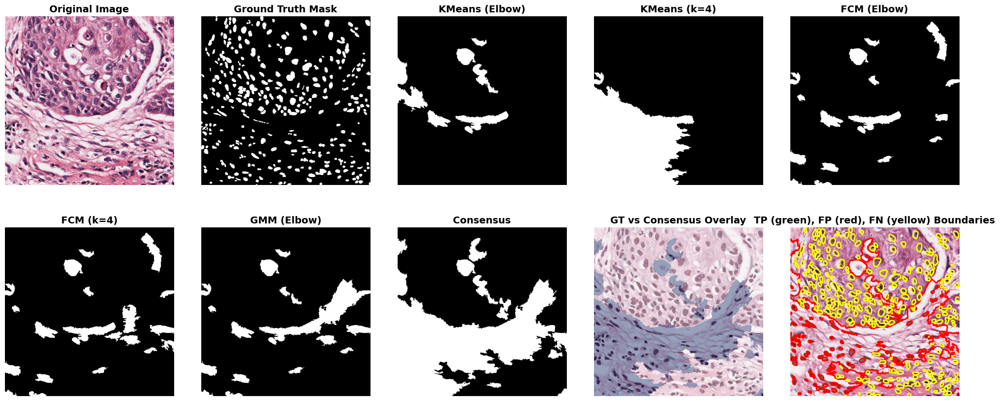

Combined visualization saved: superpixel/evaluation1/combined_segmentation_visualization_5col.png
Individual visualizations saved in superpixel/evaluation1


In [10]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import matplotlib.patches as patches

def add_border(ax, color='black', lw=2):
    """Add a neat border around the subplot axes."""
    for spine in ax.spines.values():
        spine.set_edgecolor(color)
        spine.set_linewidth(lw)

def visualize_all_and_save(image, gt_mask, masks_dict, save_dir, nuclei_cluster_method='max_intensity'):
    """
    Visualize all masks with 5 images per row, clean spacing, borders and headings.
    Row 1: Original, GT, KMeans(elbo), KMeans(4), FCM(elbo)
    Row 2: FCM(4), GMM(elbo), Consensus, GT & Consensus Overlay, TP/FP/FN Boundaries
    Save combined plot and individual plots.
    """
    os.makedirs(save_dir, exist_ok=True)
    
    # Binarize masks
    image_gray = image.mean(axis=2) if image.ndim == 3 else image
    binary_masks = {}
    for key, mask in masks_dict.items():
        binary_masks[key] = binarize_cluster_mask(mask, image_gray, nuclei_cluster_method)
    binary_masks['gt_mask'] = gt_mask
    binary_masks['original'] = image
    
    # Define order and titles for 10 plots
    keys_order = ['original', 'gt_mask',
                  'kmeans_elbow', 'kmeans_4', 'fcm_elbow',
                  'fcm_4', 'gmm_elbow', 'consensus_4',
                  'overlay', 'tp_fp_fn']
    titles = ['Original Image', 'Ground Truth Mask',
              'KMeans (Elbow)', 'KMeans (k=4)', 'FCM (Elbow)',
              'FCM (k=4)', 'GMM (Elbow)', 'Consensus',
              'GT vs Consensus Overlay', 'TP (green), FP (red), FN (yellow) Boundaries']
    
    # Prepare masks for last two special plots
    # Overlay: GT vs Consensus
    overlay_gt = binary_masks['gt_mask']
    overlay_pred = binary_masks['consensus_4']

    # TP, FP, FN masks
    tp_mask = (overlay_gt == 1) & (overlay_pred == 1)
    fp_mask = (overlay_gt == 0) & (overlay_pred == 1)
    fn_mask = (overlay_gt == 1) & (overlay_pred == 0)
    
    # Create combined figure: 2 rows, 5 cols
    fig, axes = plt.subplots(2, 5, figsize=(25, 10))
    axes = axes.flatten()
    
    for i, key in enumerate(keys_order):
        ax = axes[i]
        if key == 'original':
            ax.imshow(image)
        elif key == 'gt_mask':
            ax.imshow(binary_masks[key], cmap='gray')
        elif key in binary_masks:
            ax.imshow(binary_masks[key], cmap='gray')
        elif key == 'overlay':
            ax.imshow(image)
            ax.imshow(overlay_gt, cmap='Reds', alpha=0.4)
            ax.imshow(overlay_pred, cmap='Blues', alpha=0.4)
        elif key == 'tp_fp_fn':
            ax.imshow(image)
            for mask, color in zip([tp_mask, fp_mask, fn_mask], ['green', 'red', 'yellow']):
                contours = measure.find_contours(mask, 0.5)
                for contour in contours:
                    ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color=color)
        
        ax.set_title(titles[i], fontsize=14, weight='bold')
        ax.axis('off')
        add_border(ax, color='black', lw=2)
    
    plt.subplots_adjust(wspace=0.15, hspace=0.25)
    combined_path = os.path.join(save_dir, "combined_segmentation_visualization_5col.png")
    plt.savefig(combined_path, bbox_inches='tight', dpi=150)
    plt.show()
    plt.close()
    print(f"Combined visualization saved: {combined_path}")
    
    # Save individual images
    for i, key in enumerate(keys_order):
        fig_ind, ax_ind = plt.subplots(1, 1, figsize=(6, 6))
        if key == 'original':
            ax_ind.imshow(image)
        elif key == 'gt_mask':
            ax_ind.imshow(binary_masks[key], cmap='gray')
        elif key in binary_masks:
            ax_ind.imshow(binary_masks[key], cmap='gray')
        elif key == 'overlay':
            ax_ind.imshow(image)
            ax_ind.imshow(overlay_gt, cmap='Reds', alpha=0.4)
            ax_ind.imshow(overlay_pred, cmap='Blues', alpha=0.4)
        elif key == 'tp_fp_fn':
            ax_ind.imshow(image)
            for mask, color in zip([tp_mask, fp_mask, fn_mask], ['green', 'red', 'yellow']):
                contours = measure.find_contours(mask, 0.5)
                for contour in contours:
                    ax_ind.plot(contour[:, 1], contour[:, 0], linewidth=2, color=color)
        ax_ind.set_title(titles[i], fontsize=16, weight='bold')
        ax_ind.axis('off')
        add_border(ax_ind, color='black', lw=3)
        fname = key if key != 'gt_mask' else 'gt'
        save_fp = os.path.join(save_dir, f"{fname}.png")
        fig_ind.savefig(save_fp, bbox_inches='tight', dpi=150)
        plt.close(fig_ind)
    
    print(f"Individual visualizations saved in {save_dir}")

# Example usage (assuming you have the variables ready):
masks_dict = {
    'kmeans_elbow': masks_elbow['kmeans'],
    'kmeans_4': masks_k4['kmeans'],
    'fcm_elbow': masks_elbow['fcm'],
    'fcm_4': masks_k4['fcm'],
    'gmm_elbow': masks_elbow['gmm'],
    'gmm_4': masks_k4['gmm'],
    'consensus_4': masks_k4['consensus']
}

visualize_all_and_save(image_float, gt_mask.astype(np.uint8), masks_dict, save_dir='superpixel/evaluation1')




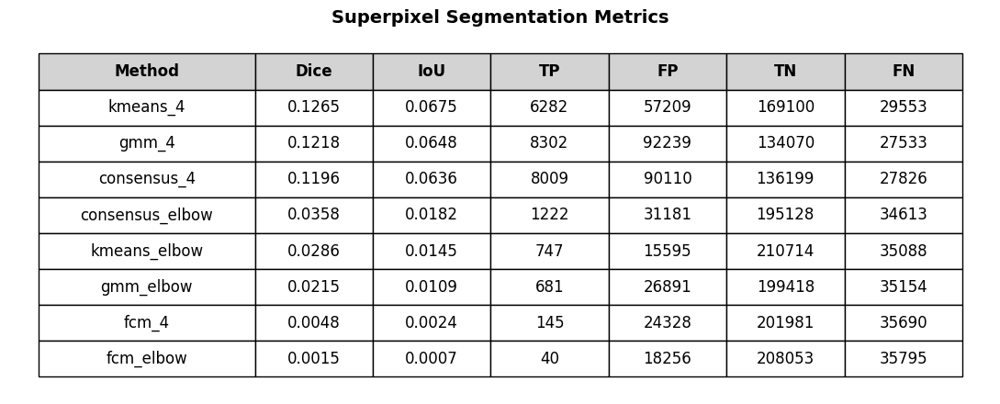

In [11]:
import matplotlib.pyplot as plt
import pandas as pd

data = [
    {'Method': 'kmeans_4', 'Dice': 0.126493, 'IoU': 0.067516, 'TP': 6282, 'FP': 57209, 'TN': 169100, 'FN': 29553},
    {'Method': 'gmm_4', 'Dice': 0.121752, 'IoU': 0.064822, 'TP': 8302, 'FP': 92239, 'TN': 134070, 'FN': 27533},
    {'Method': 'consensus_4', 'Dice': 0.119578, 'IoU': 0.063591, 'TP': 8009, 'FP': 90110, 'TN': 136199, 'FN': 27826},
    {'Method': 'consensus_elbow', 'Dice': 0.035816, 'IoU': 0.018234, 'TP': 1222, 'FP': 31181, 'TN': 195128, 'FN': 34613},
    {'Method': 'kmeans_elbow', 'Dice': 0.028633, 'IoU': 0.014525, 'TP': 747, 'FP': 15595, 'TN': 210714, 'FN': 35088},
    {'Method': 'gmm_elbow', 'Dice': 0.021480, 'IoU': 0.010857, 'TP': 681, 'FP': 26891, 'TN': 199418, 'FN': 35154},
    {'Method': 'fcm_4', 'Dice': 0.004809, 'IoU': 0.002410, 'TP': 145, 'FP': 24328, 'TN': 201981, 'FN': 35690},
    {'Method': 'fcm_elbow', 'Dice': 0.001478, 'IoU': 0.000739, 'TP': 40, 'FP': 18256, 'TN': 208053, 'FN': 35795},
]

df = pd.DataFrame(data)

df['Dice'] = df['Dice'].map('{:.4f}'.format)
df['IoU'] = df['IoU'].map('{:.4f}'.format)
df[['TP', 'FP', 'TN', 'FN']] = df[['TP', 'FP', 'TN', 'FN']].astype(int)

fig, ax = plt.subplots(figsize=(11, 4.5))  # Slightly wider & taller

ax.axis('off')

table = ax.table(
    cellText=df.values,
    colLabels=df.columns,
    cellLoc='center',
    loc='center',
    colColours=["#f9f9f9"] * len(df.columns),
    edges='closed'
)

table.auto_set_font_size(False)
table.set_fontsize(12)

# Increase row height and add padding
for (row, col), cell in table.get_celld().items():
    cell.set_height(0.1)  # Increase row height
    cell.set_edgecolor('black')
    cell.PAD = 0.02  # Add padding inside cells (default is 0.01)

# Bold header row and set background color
for col in range(len(df.columns)):
    cell = table[0, col]
    cell.set_text_props(weight='bold', color='black')
    cell.set_facecolor('#d3d3d3')  # Light grey header background

# Adjust column widths manually for balance
col_widths = [0.22, 0.12, 0.12, 0.12, 0.12, 0.12, 0.12]
for i, width in enumerate(col_widths):
    for key, cell in table.get_celld().items():
        if key[1] == i:
            cell.set_width(width)

# Reduce title-to-table space
plt.title("Superpixel Segmentation Metrics", fontsize=14, weight='bold', pad=10)  # pad=10 reduces space

plt.tight_layout()
plt.savefig("superpixel-metric.png", dpi=300, bbox_inches='tight')
plt.show()


In [15]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import tifffile
from lxml import etree
from scipy.ndimage import center_of_mass

def xml_to_masks(xml_path, image_shape):
    tree = etree.parse(xml_path)
    root = tree.getroot()
    gt_mask = np.zeros(image_shape[:2], dtype=np.uint8)
    instance_mask = np.zeros(image_shape[:2], dtype=np.uint16)
    label_id = 1
    for annotation in root.findall('.//Annotation'):
        for region in annotation.findall('.//Region'):
            points = [(int(float(v.get('X'))), int(float(v.get('Y')))) for v in region.findall('.//Vertex')]
            if len(points) >= 3:
                contour = np.array(points, dtype=np.int32)
                cv2.fillPoly(gt_mask, [contour], 255)
                cv2.fillPoly(instance_mask, [contour], label_id)
                label_id += 1
    return gt_mask, instance_mask

def get_nuclei_centroids(instance_mask):
    ids = np.unique(instance_mask)
    ids = ids[ids != 0]
    centroids = np.array(center_of_mass(instance_mask > 0, instance_mask, ids))
    return np.array(centroids)[:, [1, 0]]  # (x, y)

def rescale_coords(coords, from_shape, to_shape):
    scale_x = to_shape[1] / from_shape[1]
    scale_y = to_shape[0] / from_shape[0]
    coords_scaled = coords.copy()
    coords_scaled[:, 0] *= scale_x  # x
    coords_scaled[:, 1] *= scale_y  # y
    return coords_scaled

def plot_and_save_consensus_with_nuclei(consensus_mask, nuclei_coords, title, save_path):
    plt.figure(figsize=(10, 10))
    ax = plt.gca()
    ax.imshow(consensus_mask, cmap='tab10')
    ax.scatter(nuclei_coords[:, 0], nuclei_coords[:, 1], s=6, c='black')  # black dots
    ax.set_title(title, fontsize=16, weight='bold', pad=15)
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_edgecolor('gray')
        spine.set_linewidth(1.5)
    ax.axis('off')
    plt.savefig(save_path, bbox_inches='tight', dpi=300)
    plt.close()
    print(f"[SAVED] {save_path}")


def main_nuclei_overlay():
    image_path = 'TCGA-21-5784-01Z-00-DX1.tif'
    xml_path = 'TCGA-21-5784-01Z-00-DX1.xml'
    
    # Load image and masks
    image = tifffile.imread(image_path)
    gt_mask, instance_mask = xml_to_masks(xml_path, image.shape)
    nuclei_coords = get_nuclei_centroids(instance_mask)

    global masks_k4, masks_elbow, final_k  # must be defined in your workspace already

    # Rescale nuclei coords to consensus mask size
    consensus_shape = masks_k4['consensus'].shape
    original_shape = instance_mask.shape
    nuclei_coords_scaled = rescale_coords(nuclei_coords, original_shape, consensus_shape)

    # Save consensus overlays with nuclei
    plot_and_save_consensus_with_nuclei(
        masks_k4['consensus'],
        nuclei_coords_scaled,
        title='Consensus Segmentation (k=4) with Nuclei',
        save_path='consensus_k4_with_nuclei.png'
    )

    consensus_shape_opt = masks_elbow['consensus'].shape
    nuclei_coords_scaled_opt = rescale_coords(nuclei_coords, original_shape, consensus_shape_opt)

    plot_and_save_consensus_with_nuclei(
        masks_elbow['consensus'],
        nuclei_coords_scaled_opt,
        title=f'Consensus Segmentation (Optimal k={final_k}) with Nuclei',
        save_path=f'consensus_k{final_k}_with_nuclei.png'
    )

# Run this after your main() to generate and save the images
main_nuclei_overlay()


[SAVED] consensus_k4_with_nuclei.png
[SAVED] consensus_k7_with_nuclei.png
